# Assignment 1_2: Cross Entropy

## Goal
- Language Modeling에 따른 Cross Entropy 구현
- N-gram Generation, Word Counting, Cleaning Revisit
- Smoothing (Add-1) implementation

### Entropy

In Information Theory, entropy (denoted $H(X)$) of a random variable X is the expected log probabiltiy:

\begin{equation}
    H(X) = - \sum P(x)log_2 P(x)
\end{equation}

and is a measure of uncertainty. 


### Defn: Cross Entropy

The cross entropy, H(p,m), of a true distribution **p** and a model distribution **m** is defined as:

\begin{equation}
    H(p,m) = - \sum_{x} p(x) log_2 m(x)
\end{equation}

The lower the cross entropy is the closer it is to the true distribution.

## Contents
- Group Assignment1에서 사용했던 NLRW1900000011.json 은 강원일보의 뉴스기사이다. (training data로 사용)
- NLRW1900000020.json 은 강원일보 뉴스 기사이다. (test data로 사용)
- 국립국어원의 문어체 코퍼스 (WRITTEN) 중의 하나인 WARW1900003745.json (첨부)은 나니야 연대기 소설 자료이다. (test data로 사용)
- training data에서 학습한 한글 글자(음절) 별 unigram, Bigram, trigram 모델이 같은 신문기사와 소설에 얼마나 잘 부합하는지를 교차 엔트로피로 살펴봄
- 세 데이터에서 "form"에 해당하는 부분만을 각각 추출하여, 한글 글자들만 남긴 후 (스페이스도 고려) unigram, bigram, trigram 구성을 만들고 빈도를 구함
- 한글은 논리적으로 초*중*종 결합인 19 x 21 x 28(받침없는 Filler포함) = 11,172자의 글자(음절) 표현 가능

<!-- 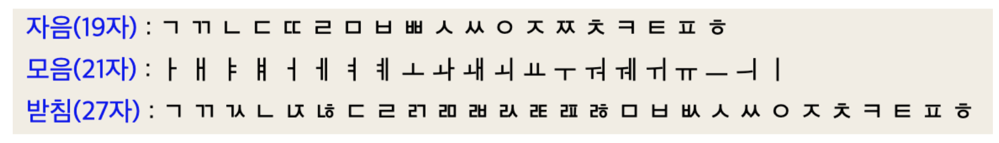 -->

* 총 11,172 가능한 음절 중 실제로 코퍼스에 나타난 각 음절에 대해  엔트로피를 다음과 같이 계산 (유니그램)

H(X) = -p(가) x log2 p(가) -p(각) log2 x p(각) ...- p(힣) x log2 p(힣)

- bigram, trigram의 경우도 각각의 코퍼스에서 나타나는 구성을 구하면 됨.
- 트레이닝 코퍼스에서 학습한 모델이 각각 테스트 데이터에 얼마나 부합하는지를 교차엔트로피를 계산하고 그 차이를 보이는 다음의 표를 출력하라.
Difference: H(P,m) - H(p)


<!-- 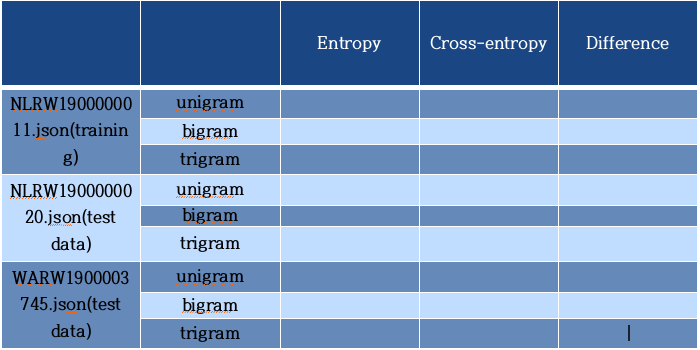 -->

- training 코퍼스에서는 entropy와 cross entropy는 같고 따라서 그 차이는 0이다
- 코퍼스에서 테스트 하기 위한 테스트 코퍼스의 교차엔트로피는 각 모델의 확률을 구하고 이를 교차 엔트로피 공식에 따라 구하면 되는데, **이 경우 P(x)는 이 test 코퍼스의 각 글자별 확률이고 모델의 확률인 logp(m)은 training 코퍼스인 코퍼스에서 구해진 각 모델의 확률이다.** 각 글자별로 이를 다 곱해서 더 하면 교차엔트로피가 구해진다. 즉 training테스트에서 설정한 언어모델이 test 코퍼스에 더 부합할수록 모델의 확률도 training의 확률과 같을 것이고 따라서 엔트로피와 교차엔트로피의 차이는 H(P,m) - H(p)로 그 차이가 작을수록 더 좋은 모델이 된다. 
- 이 경우 training 코퍼스에 없는 n-gram 구성이  test 코퍼스에 있을 경우 문제가 되니 이 구성의 확률을 얻기 위해 ADD-1을 사용해서 smoothing하라.
(힌트: training 데이터의 각 n-gram모델의 구성과 test-data의 n-gram모델의 구성을 비교하여 빠져 있는 구성을 보충하고 add-1을 사용해서 확률을 구함)

In [2]:
import pandas as pd
import json

mother_path = "/home/hyohyeongjang/2024aut_comstudy1/data"
training_data = f"{mother_path}/NLRW1900000011.json"
test_data1 = f"{mother_path}/NLRW1900000020.json"
test_data2 = f"{mother_path}/WARW1900003745.json"

with open(training_data, "r") as f:
    x = json.load(f)
print(x)

{'id': 'NLRW1900000011', 'metadata': {'title': '국립국어원 신문 말뭉치 NLRW1900000011', 'creator': '국립국어원', 'distributor': '국립국어원', 'year': '2019', 'category': '신문 > 지역 종합지', 'annotation_level': ['원시'], 'sampling': '부분 추출 - 임의 추출'}, 'document': [{'id': 'NLRW1900000011.1', 'metadata': {'title': '강원일보 2009년 기사', 'author': '강원일보', 'publisher': '강원일보', 'date': '20090101', 'topic': '사회', 'original_topic': '사설'}, 'paragraph': [{'id': 'NLRW1900000011.1.1', 'form': '새로운 희망 공유하고 새 출발하자'}, {'id': 'NLRW1900000011.1.2', 'form': '기축년(己丑年) 새해다.새로운 희망을 공유하고 새 출발을 다짐할 때다.짙푸른 동해바다를 뚫고 이글거리는 광채를 뿜으며 힘차게 솟아오르는 태양을 안는다.'}, {'id': 'NLRW1900000011.1.3', 'form': '어제와 다른 이 아침의 햇살을 받으며 왜 간절한 소망이 없겠는가.지난날의 갈등과 혼란 회한을 뒤로하고 새로 일어서야 한다.올해는 불신과 증오, 암투와 음모, 좌절과 절망 등 어둡고 참담한 것들이 걷히기를 소망한다.경제위기라고 하지만 우리는 저력을 가지고 있다.'}, {'id': 'NLRW1900000011.1.4', 'form': '남북관계 새 틀 모색해야'}, {'id': 'NLRW1900000011.1.5', 'form': '우리의 역사는 위기와 극복의 과정으로 이어져 왔다.시련과 고난을 극복하는 과정에서 오히려 민족의 역량을 키우고 한 단계 발전을 이룩해 왔던 것이다.달군 쇠가 단단해지고, 비 온 뒤의 땅이 굳어진다는 것은 마치 우리

In [3]:
x

{'id': 'NLRW1900000011',
 'metadata': {'title': '국립국어원 신문 말뭉치 NLRW1900000011',
  'creator': '국립국어원',
  'distributor': '국립국어원',
  'year': '2019',
  'category': '신문 > 지역 종합지',
  'annotation_level': ['원시'],
  'sampling': '부분 추출 - 임의 추출'},
 'document': [{'id': 'NLRW1900000011.1',
   'metadata': {'title': '강원일보 2009년 기사',
    'author': '강원일보',
    'publisher': '강원일보',
    'date': '20090101',
    'topic': '사회',
    'original_topic': '사설'},
   'paragraph': [{'id': 'NLRW1900000011.1.1', 'form': '새로운 희망 공유하고 새 출발하자'},
    {'id': 'NLRW1900000011.1.2',
     'form': '기축년(己丑年) 새해다.새로운 희망을 공유하고 새 출발을 다짐할 때다.짙푸른 동해바다를 뚫고 이글거리는 광채를 뿜으며 힘차게 솟아오르는 태양을 안는다.'},
    {'id': 'NLRW1900000011.1.3',
     'form': '어제와 다른 이 아침의 햇살을 받으며 왜 간절한 소망이 없겠는가.지난날의 갈등과 혼란 회한을 뒤로하고 새로 일어서야 한다.올해는 불신과 증오, 암투와 음모, 좌절과 절망 등 어둡고 참담한 것들이 걷히기를 소망한다.경제위기라고 하지만 우리는 저력을 가지고 있다.'},
    {'id': 'NLRW1900000011.1.4', 'form': '남북관계 새 틀 모색해야'},
    {'id': 'NLRW1900000011.1.5',
     'form': '우리의 역사는 위기와 극복의 과정으로 이어져 왔다.시련과 고난을 극복하는 과정에서 오히

## General
- 마감: 10월 1일 화요일 밤 11시 59분 59초!
- 화일 이름은 Assignment1_2_학번_이름.ipynb
- 코드, 또는 셀 마다 자세한 설명 요함